<Figure size 640x480 with 0 Axes>

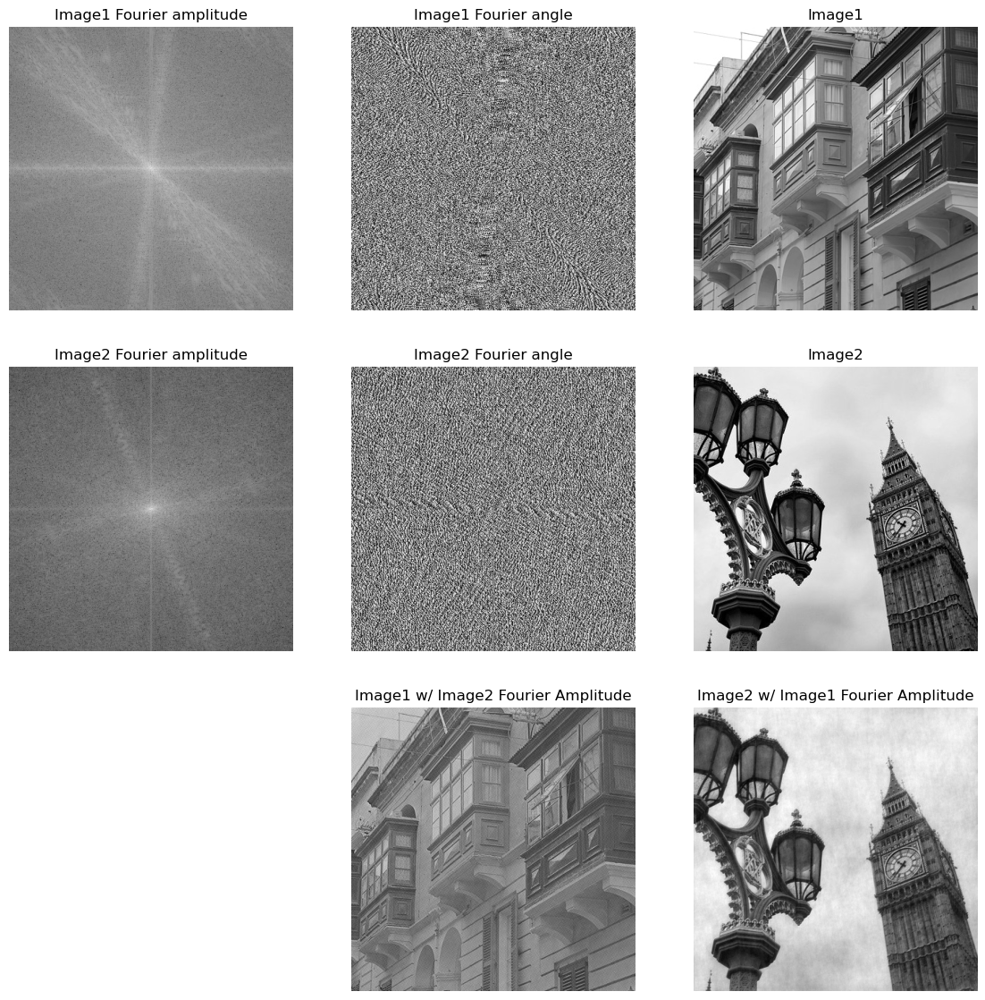

<Figure size 640x480 with 0 Axes>

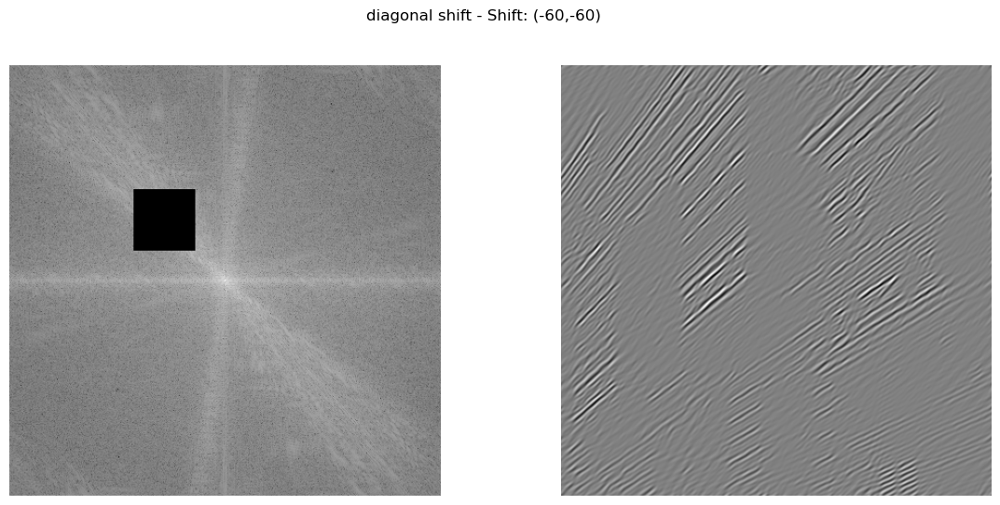

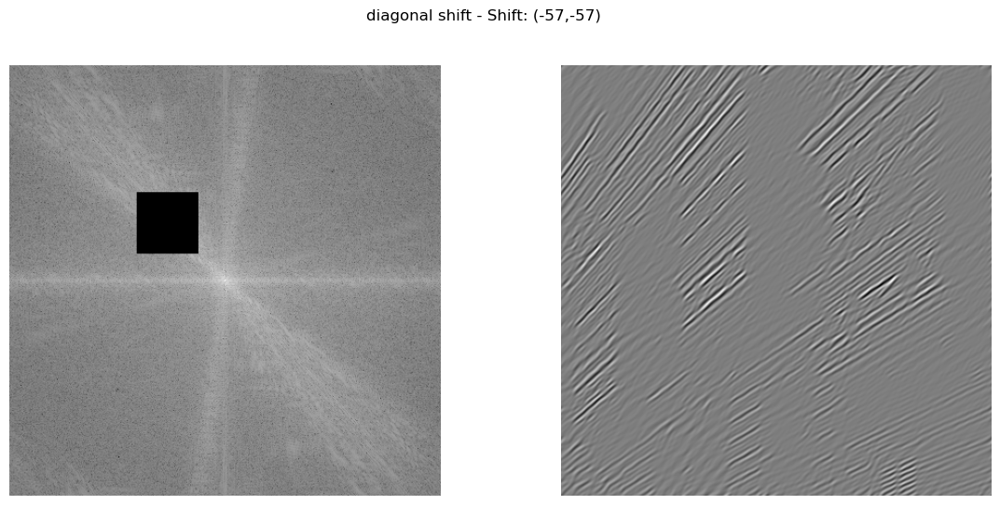

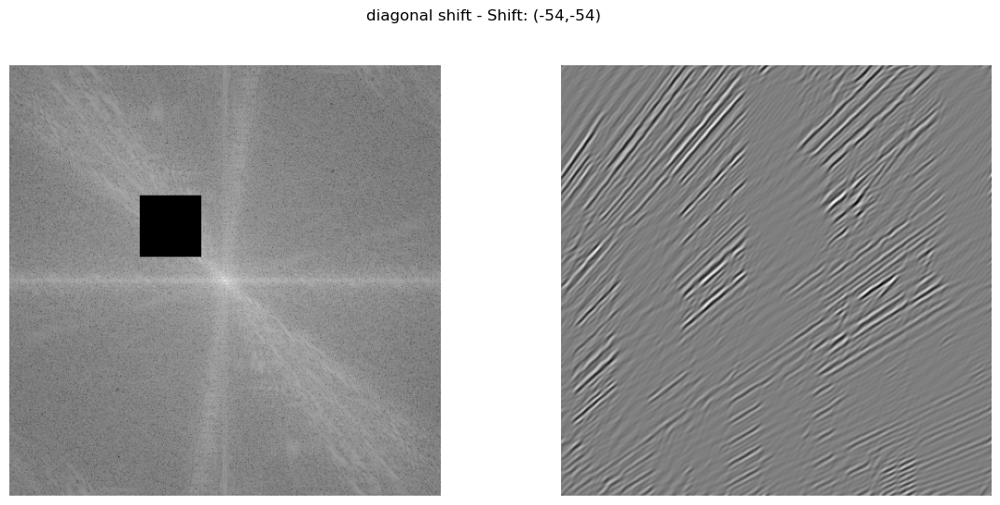

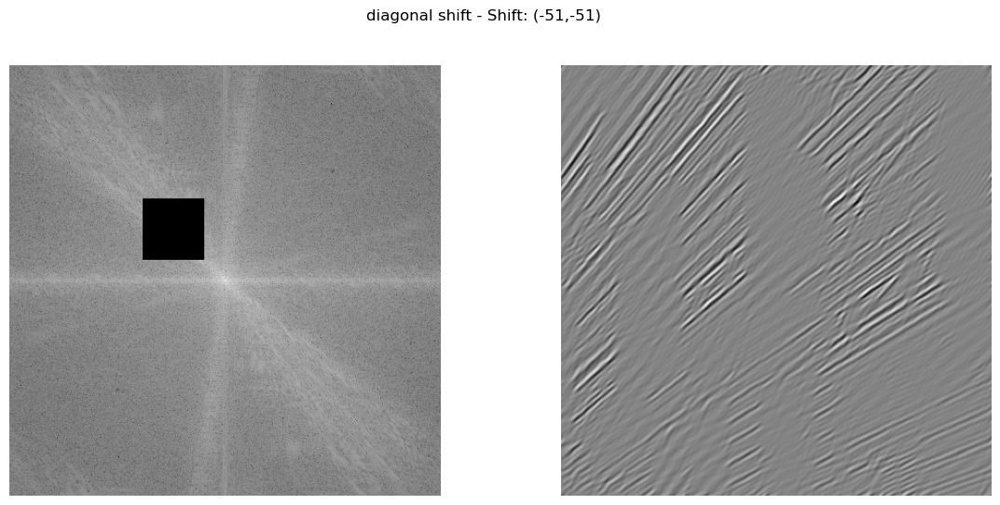

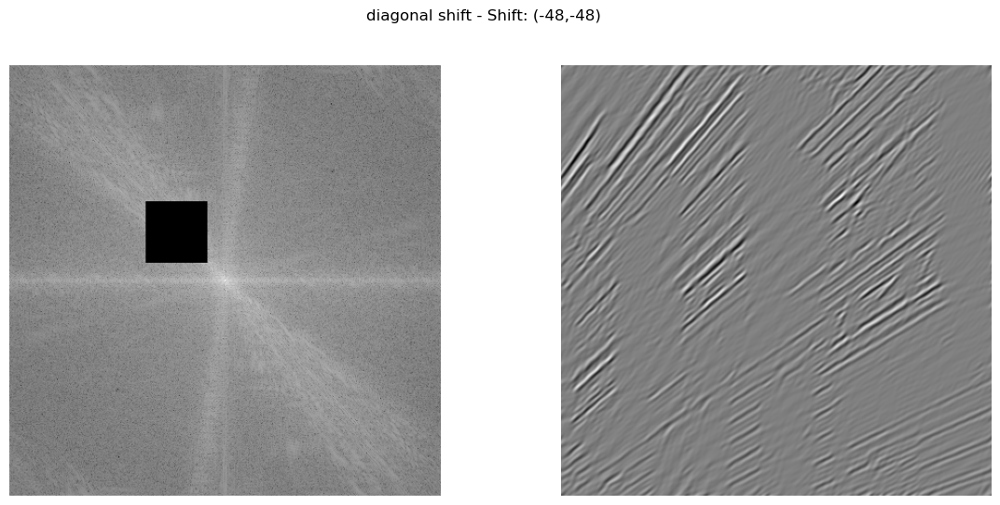

...

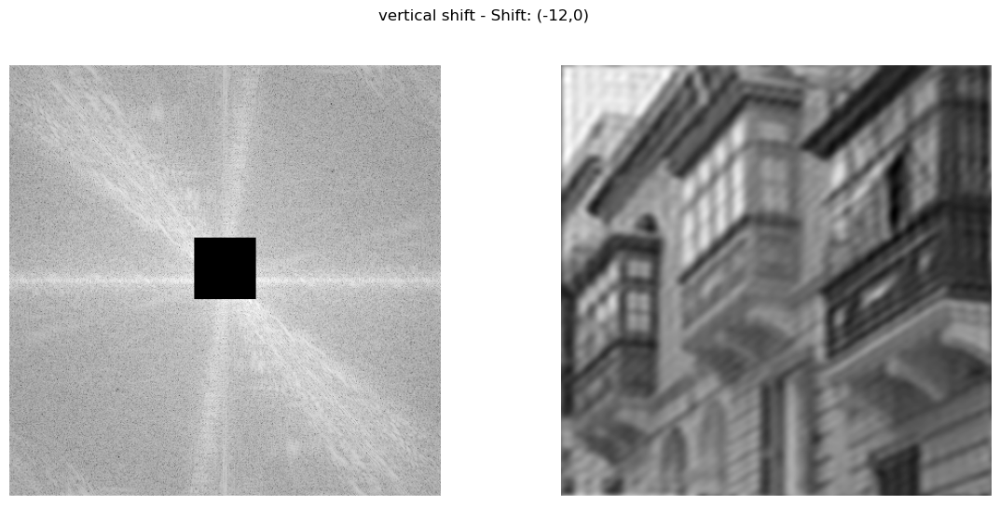

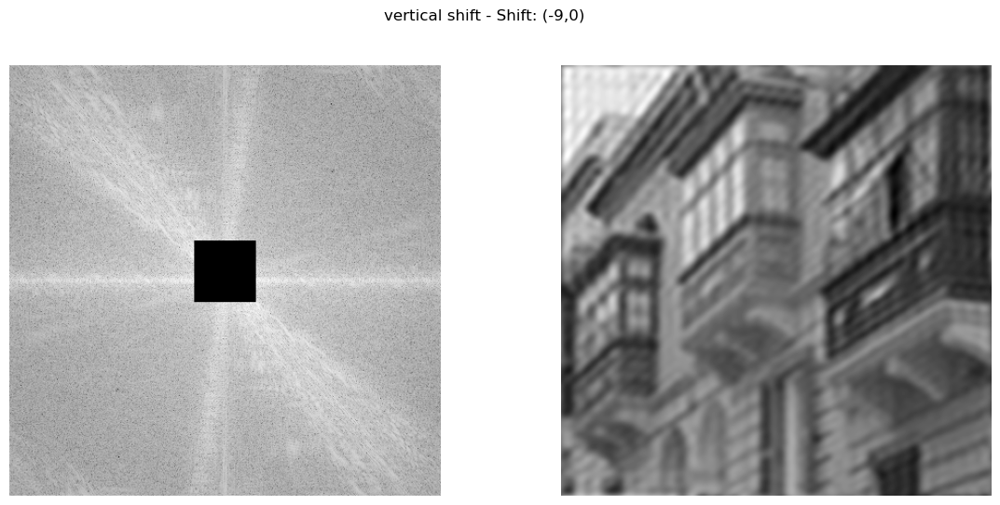

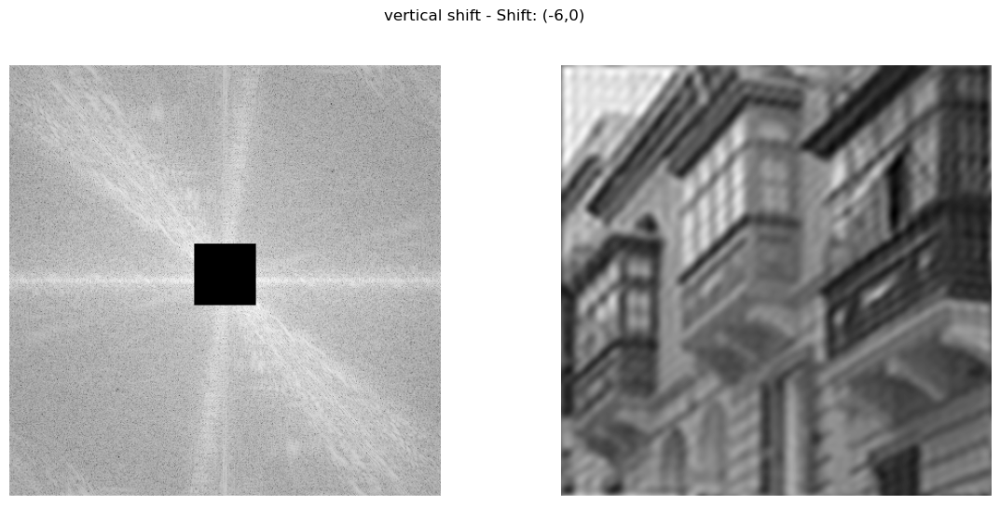

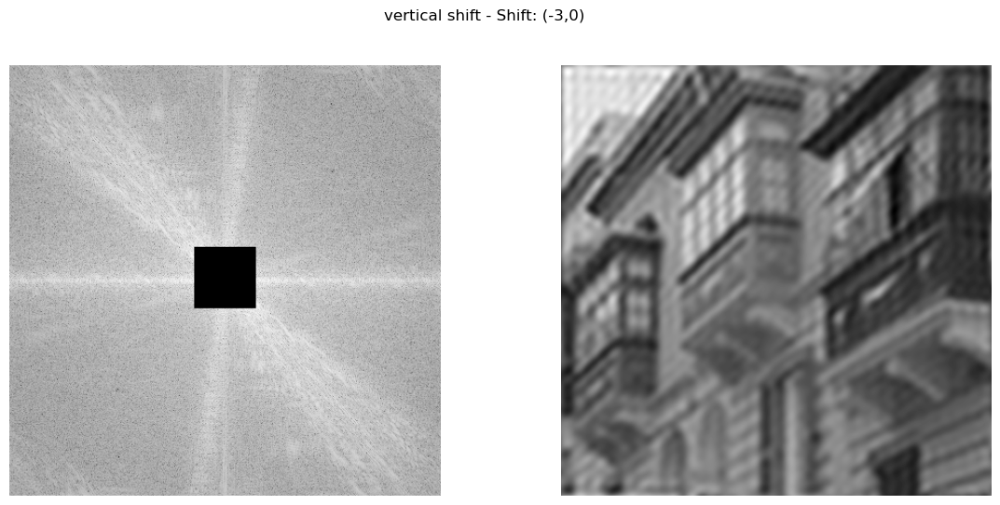

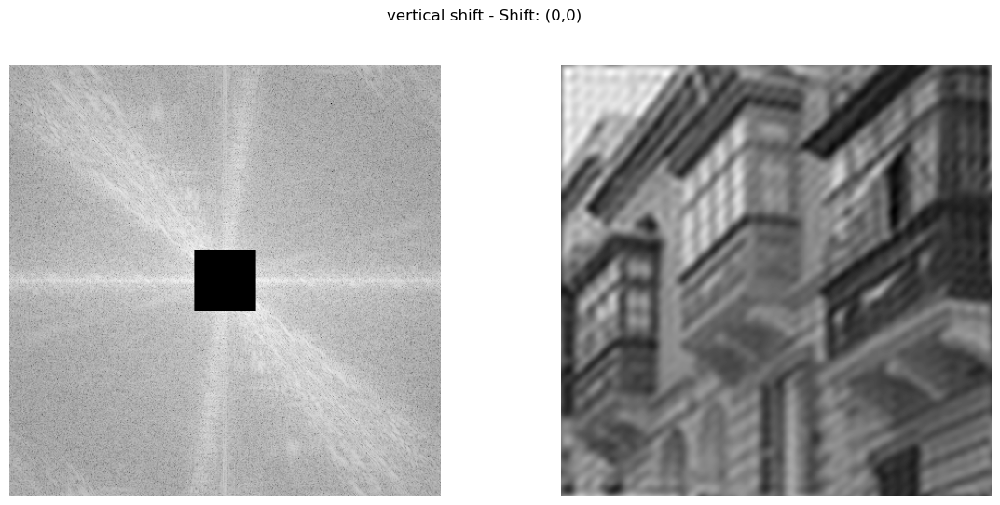

In [34]:
# fourier_clipping.py

import numpy as np
import matplotlib.pyplot as plt

image_filename = "Malta_Balconies.png"
image2_filename = "Elizabeth_Tower_London.jpg" #"Elizabeth_Tower_London.jpg"

def calculate_2dft(input):
    ft = np.fft.ifftshift(input)
    ft = np.fft.fft2(ft)
    return np.fft.fftshift(ft)

def calculate_2dift(input):
    ift = np.fft.ifftshift(input)
    ift = np.fft.ifft2(ift)
    ift = np.fft.fftshift(ift)
    return ift.real

def cropsquare(input, center, squareradius, squareshift):
    topLeftCoord = center - squareradius + squareshift
    bottomRightCoord = center + squareradius + squareshift
    value = np.zeros_like(input)
    value[topLeftCoord[0]: bottomRightCoord[0]+1, topLeftCoord[1]: bottomRightCoord[1]+1] = input[topLeftCoord[0]: bottomRightCoord[0]+1, topLeftCoord[1]: bottomRightCoord[1]+1]
    return value

def removesquare(input, center, squareradius, squareshift):
    topLeftCoord = center - squareradius + squareshift
    bottomRightCoord = center + squareradius + squareshift
    value = input.copy()
    value[topLeftCoord[0]: bottomRightCoord[0]+1, topLeftCoord[1]: bottomRightCoord[1]+1] = np.min(value) #input[topLeftCoord[0]: bottomRightCoord[0]+1, topLeftCoord[1]: bottomRightCoord[1]+1]
    return value

def calculate_distance_from_centre(coords, centre):
    # Distance from centre is √(x^2 + y^2)
    return np.sqrt(
        (coords[0] - centre) ** 2 + (coords[1] - centre) ** 2
    )

def find_symmetric_coordinates(coords, centre):
    return (centre + (centre - coords[0]),
            centre + (centre - coords[1]))

def display_plots(individual_grating, reconstruction, shift, extraTitle = ''):
    plt.figure(figsize=(14,6))
    plt.subplot(121)
    plt.imshow(individual_grating,cmap='gray',norm=None)
    plt.axis("off")
    plt.subplot(122)
    plt.imshow(reconstruction,cmap='gray',norm=None)
    plt.axis("off")
    # plt.suptitle(f"Terms: {idx}")
    plt.suptitle(f"{extraTitle} - Shift: ({shift[0]},{shift[1]})")
    plt.pause(0.01)

def create_circular_mask(h, w, center=None, radius=None):

    if center is None: # use the middle of the image
        center = (int(w/2), int(h/2))
    if radius is None: # use the smallest distance between the center and image walls
        radius = min(center[0], center[1], w-center[0], h-center[1])

    Y, X = np.ogrid[:h, :w]
    dist_from_center = np.sqrt((X - center[1])**2 + (Y-center[0])**2)

    mask = dist_from_center <= radius
    return mask

# Read and process image
image = plt.imread(image_filename)
image2 = plt.imread(image2_filename)
image = image[:, :, :3].mean(axis=2)  # Convert to grayscale
image2 = image2[:, :, :3].mean(axis=2)  # Convert to grayscale
# Array dimensions (array is square) and centre pixel
# Use smallest of the dimensions and ensure it's odd
array_size = min(image2.shape) - 1 + min(image2.shape) % 2 #Reshape first image to second image (which should be smaller!)
array_size2 = min(image2.shape) - 1 + min(image2.shape) % 2
# Crop image so it's a square image
image = image[:array_size, :array_size]
image2 = image2[:array_size2, :array_size2]
centre = int((array_size - 1) / 2)
centre2 = int((array_size2 - 1) / 2)
# Get all coordinate pairs in the left half of the array,
# including the column at the centre of the array (which
# includes the centre pixel)
coords_left_half = (
    (x, y) for x in range(array_size) for y in range(centre+1)
)
coords_left_half2 = (
    (x, y) for x in range(array_size2) for y in range(centre2+1)
)
# Sort points based on distance from centre
coords_left_half = sorted(
    coords_left_half,
    key=lambda x: calculate_distance_from_centre(x, centre)
)
coords_left_half2 = sorted(
    coords_left_half2,
    key=lambda x: calculate_distance_from_centre(x, centre2)
)
plt.set_cmap("gray")
ft = calculate_2dft(image)
ft2 = calculate_2dft(image2)
ft1b = ft / np.log(abs(ft)) * np.log(abs(ft2)) #change amplitude of ft1 to amplitude of ft2.
ft2b = ft2 / np.log(abs(ft2)) * np.log(abs(ft)) #change amplitude of ft2 to amplitude of ft.
image1_ampImage2 = calculate_2dift(ft1b)
image2_ampImage1 = calculate_2dift(ft2b)
# Show grayscale images and Fourier transforms (both amplitude and angle)
plt.figure(figsize=(14,14))
plt.subplot(331)
plt.gca().set_title('Image1 Fourier amplitude')
plt.axis("off")
plt.imshow(np.log(abs(ft)))
plt.subplot(332)
plt.gca().set_title('Image1 Fourier angle')
plt.axis("off")
plt.imshow(np.angle(ft))
plt.subplot(333)
plt.gca().set_title('Image1')
plt.axis("off")
plt.imshow(image)
plt.subplot(334)
plt.gca().set_title('Image2 Fourier amplitude')
plt.axis("off")
plt.imshow(np.log(abs(ft2)))
plt.subplot(335)
plt.gca().set_title('Image2 Fourier angle')
plt.axis("off")
plt.imshow(np.angle(ft2))
plt.subplot(336)
plt.gca().set_title('Image2')
plt.axis("off")
plt.imshow(image2)
plt.subplot(338)
plt.gca().set_title('Image1 w/ Image2 Fourier Amplitude')
plt.axis("off")
plt.imshow(image1_ampImage2)
plt.subplot(339)
plt.gca().set_title('Image2 w/ Image1 Fourier Amplitude')
plt.axis("off")
plt.imshow(image2_ampImage1)
plt.pause(2)
# Reconstruct image
fig = plt.figure()
# Step 1
# Set up empty arrays for final image and
# individual gratings
rec_image = np.zeros(image.shape)
individual_grating = np.zeros(
    image.shape, dtype="complex"
)
idx = 0
# All steps are displayed until display_all_until value
display_all_until = 5 #200
# After this, skip which steps to display using the
# display_step value
display_step = 10
# Work out index of next step to display
next_display = display_all_until + display_step

# Crop squares with radius 30.
cropradius = 30
shiftiterate = 3
# Move horizontal & vertical diagonally along frequencies
for j in range(-20,1):
    i = j
    shift = np.array([i*shiftiterate,j*shiftiterate])
    ft_cropped = cropsquare(ft, np.array([centre, centre]), cropradius, shift)
    rec_image = calculate_2dift(ft_cropped)
    ft_visualize = np.log(np.abs(ft))
    ft_visualize = removesquare(ft_visualize, np.array([centre, centre]), cropradius, shift)
    display_plots(ft_visualize, rec_image, shift, 'diagonal shift')

# Crop squares with radius 30.
# Move along horizontal frequencies
cropradius = 30
shiftiterate = 3
for i in range(0,1):
    for j in range(-20,1):
        shift = np.array([i*shiftiterate,j*shiftiterate])
        ft_cropped = cropsquare(ft, np.array([centre, centre]), cropradius, shift)
        rec_image = calculate_2dift(ft_cropped)
        ft_visualize = np.log(np.abs(ft))
        ft_visualize = removesquare(ft_visualize, np.array([centre, centre]), cropradius, shift)
        display_plots(ft_visualize, rec_image, shift, 'horizontal shift')

# Crop squares with radius 30.
# Move along vertical frequencies
cropradius = 30
shiftiterate = 3
for i in range(-20,1):
    for j in range(0,1):
        shift = np.array([i*shiftiterate,j*shiftiterate])
        ft_cropped = cropsquare(ft, np.array([centre, centre]), cropradius, shift)
        rec_image = calculate_2dift(ft_cropped)
        ft_visualize = np.log(np.abs(ft))
        ft_visualize = removesquare(ft_visualize, np.array([centre, centre]), cropradius, shift)
        display_plots(ft_visualize, rec_image, shift, 'vertical shift')
        
# # Crop circles (:P) and squares with radius 50, shifted 50 a few times in each direction
# cropradius = 50
# shiftiterate = 50
# for i in range(-1,2):
#     for j in range(-1,3):
#         shift = np.array([i*shiftiterate,j*shiftiterate])
#         ft_cropped = cropsquare(ft, np.array([centre, centre]), cropradius, shift)
#         rec_image = calculate_2dift(ft_cropped)
#         ft_visualize = np.log(np.abs(ft))
#         ft_visualize = removesquare(ft_visualize, np.array([centre, centre]), cropradius, shift)
#         display_plots(ft_visualize, rec_image, shift)
#         circlemask = create_circular_mask(array_size, array_size, np.array([centre,centre]) + shift, cropradius)
#         ft_cropped = circlemask * ft #cropsquare(ft, np.array([centre, centre]), cropradius, shift)
#         rec_image = calculate_2dift(ft_cropped)
#         ft_visualize = np.log(np.abs(ft))
#         ft_visualize = ~circlemask * ft_visualize + circlemask * np.min(ft_visualize)
#         display_plots(ft_visualize, rec_image, shift, 'large circle along grid')
        
# # Crop squares with radius 30.
# cropradius = 30
# shiftiterate = 30
# for i in range(-1,2):
#     for j in range(-1,3):
#         shift = np.array([i*shiftiterate,j*shiftiterate])
#         ft_cropped = cropsquare(ft, np.array([centre, centre]), cropradius, shift)
#         rec_image = calculate_2dift(ft_cropped)
#         ft_visualize = np.log(np.abs(ft))
#         ft_visualize = removesquare(ft_visualize, np.array([centre, centre]), cropradius, shift)
#         display_plots(ft_visualize, rec_image, shift, 'large square along grid')